<a href="https://colab.research.google.com/github/PranavAmarnath/U.S.-Pollution/blob/master/uspollution.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# US Pollution: Analyzing Air Quality from 4 Major Pollutants Since 2000



#### Mounting Drive - specific to Google Colab

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#### Importing all libraries

In [ ]:
!apt-get install libproj-dev proj-data proj-bin
!apt-get install libgeos-dev
!pip install cython
!pip install cartopy
!apt-get -qq install python-cartopy python3-cartopy
!pip uninstall -y shapely
!pip install shapely --no-binary shapely
!pip install scikit-learn

Reading package lists... Done
Building dependency tree       
Reading state information... Done
libproj-dev is already the newest version (4.9.3-2).
libproj-dev set to manually installed.
proj-data is already the newest version (4.9.3-2).
proj-data set to manually installed.
The following NEW packages will be installed:
  proj-bin
0 upgraded, 1 newly installed, 0 to remove and 39 not upgraded.
Need to get 32.3 kB of archives.
After this operation, 110 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 proj-bin amd64 4.9.3-2 [32.3 kB]
Fetched 32.3 kB in 0s (138 kB/s)
Selecting previously unselected package proj-bin.
(Reading database ... 155335 files and directories currently installed.)
Preparing to unpack .../proj-bin_4.9.3-2_amd64.deb ...
Unpacking proj-bin (4.9.3-2) ...
Setting up proj-bin (4.9.3-2) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...
Reading package lists... Done
Building dependency tree       
Reading state 

In [ ]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib import rc
from sklearn.linear_model import LinearRegression
from mpl_toolkits import mplot3d
from datetime import datetime
import seaborn as sns
rc('animation', html='jshtml')

import cartopy
import cartopy.crs as crs                   # for projections
import cartopy.feature as cfeature           # for features
import cartopy.io.shapereader as shapereader
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from cartopy.feature.nightshade import Nightshade

#### Changing directory (this is the path in my drive)

In [ ]:
%cd /content/drive/My\ Drive/uspollution

/content/drive/My Drive/uspollution


#### Reading CSV

In [ ]:
df_orig = pd.read_csv('pollution_us_2000_2016.csv')

In [ ]:
df_orig['Date Local'] = pd.to_datetime(df_orig['Date Local'], format='%Y-%m-%d')
df_orig = df_orig.dropna(axis='rows')
df_orig = df_orig[df_orig.State != 'Country Of Mexico']
df = df_orig.groupby(['State','Date Local']).mean()
df = df.groupby(level=0)

#### 4 AQI Subplots from 2000-2016

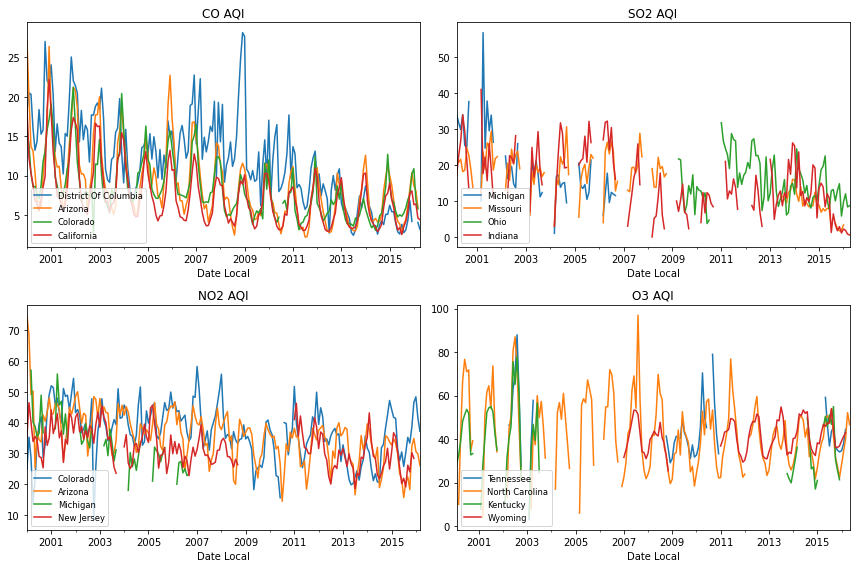

In [ ]:
def aqi_plot(pollutant):
  dfPoll = df[f'{pollutant} AQI']
  dfPollIndex = dfPoll.mean().nlargest(4).index
  for i in range(len(dfPollIndex)):
      dfPoll.get_group(dfPollIndex[i]).groupby(pd.Grouper(level='Date Local',freq='M')).mean().plot()
  plt.legend(dfPollIndex,loc=3,fontsize='small')
  plt.title(f'{pollutant} AQI')

plt.figure(figsize=(12,8))
plt.subplot(221)
aqi_plot('CO')
plt.subplot(222)
aqi_plot('SO2')
plt.subplot(223)
aqi_plot('NO2')
plt.subplot(224)
aqi_plot('O3')

plt.tight_layout()
plt.show()

#### Bubble Map of AQI for All States

In [ ]:
df_states = pd.read_csv('statelatlong.csv')
df_states = df_states[~df_states['City'].isin(['District of Columbia', 'Mississippi', 'Montana', 'Nebraska', 'Vermont', 'West Virginia', 'Wyoming'])]

In [ ]:
polls = []
aqis = []
sizes = []
scatters = []

i = 0
for state in df_states.City:
  polls.append(df_orig[(df_orig.State==state)].copy())
  polls[i]['Date Local'] = pd.to_datetime(polls[i]['Date Local'],format='%Y-%m-%d')
  aqis.append(polls[i][['Date Local','NO2 AQI']].groupby(['Date Local']))
  aqis[i] = aqis[i].mean()
  aqis[i] = aqis[i].resample('M').mean()
  sizes.append(aqis[i].iloc[0]*10)
  i += 1

latitudes = df_states.Latitude.tolist()
longitudes = df_states.Longitude.tolist()

Animation size has reached 21050343 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


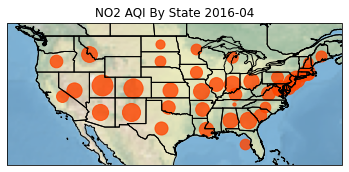

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection=crs.PlateCarree())

ax.stock_img()
ax.coastlines()
ax.add_feature(cartopy.feature.STATES)
ax.add_feature(cartopy.feature.BORDERS)

ax.set_extent([-130, -65, 24, 47])
for i in range(len(latitudes)-1):
  scatters.append(ax.scatter(x=longitudes[i], y=latitudes[i], color="orangered", s=sizes[i], alpha=0.8, transform=crs.PlateCarree()))

def update(i):
  for j in range(len(latitudes)-1):
    try:
      scatters[j].set_sizes(aqis[j].iloc[i]*10)
    except IndexError:
      continue
  ax.set_title("NO2 AQI By State " + aqis[4].index[i].strftime('%Y-%m'))
  return scatters[0],

anim = FuncAnimation(plt.gcf(),update,interval=100,blit=True,repeat=False,frames=196)
anim
#plt.show()

#### Multivariate Linear Regression of AQI

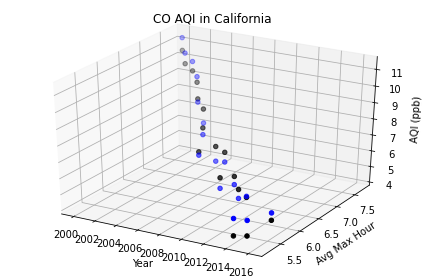

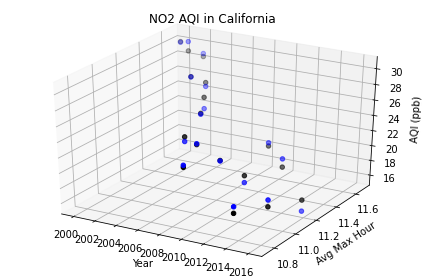

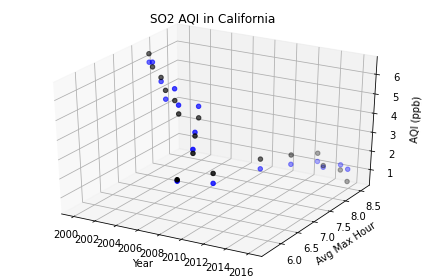

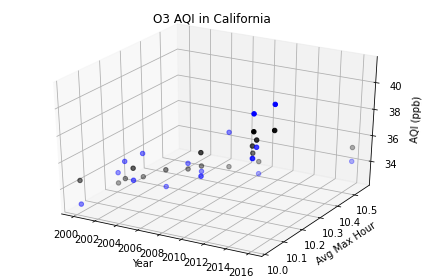

In [ ]:
def aqi_plot(pollutant, state):
  dfPoll = df[f'{pollutant} AQI']
  table_poll = dfPoll.get_group(state).groupby(pd.Grouper(level='Date Local',freq='Y')).mean()
  X = table_poll.index.tolist()
  for i in range(len(X)):
    X[i] = X[i].strftime("%Y")
    X[i] = int(X[i])
  y = table_poll.values

  dfHour = df[f'{pollutant} 1st Max Hour']
  table_hour = dfHour.get_group(state).groupby(pd.Grouper(level='Date Local',freq='Y')).mean()
  data = {'Date Local':X, f'{pollutant} Max Hour':table_hour.values}
  X = pd.DataFrame(data)

  linear_regression = LinearRegression()
  linear_regression.fit(X, y)
  y_pred = linear_regression.predict(X)

  fig = plt.figure()
  ax = plt.axes(projection='3d')
  plt.xlabel('Year')
  plt.ylabel('Avg Max Hour')
  plt.title(f'{pollutant} AQI in {state}')
  ax.set_zlabel("AQI (ppb)")
  ax.scatter3D(X.iloc[:, 0].values, X.iloc[:, 1].values, y, color="blue", label="Actual Demand")
  ax.scatter3D(X.iloc[:, 0].values, X.iloc[:, 1].values, y_pred, color="black", label="Predicted Demand")

  plt.tight_layout()

aqi_plot('CO', 'California')
aqi_plot('NO2', 'California')
aqi_plot('SO2', 'California')
aqi_plot('O3', 'California')

#### Heatmap of Pollution

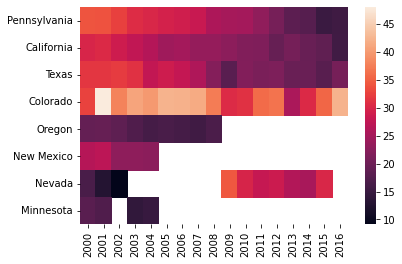

In [ ]:
def heatmap_poll(pollutant):
  dfPoll = df[f'{pollutant} AQI']
  states = ["Pennsylvania", "California", "Texas", "Colorado", "Oregon", "New Mexico", "Nevada", "Minnesota"]
  X_all = []
  y_all = []
  for state in states:
    table_poll = dfPoll.get_group(state).groupby(pd.Grouper(level='Date Local',freq='Y')).mean()
    X = table_poll.index.tolist()
    for i in range(len(X)):
      X[i] = X[i].strftime("%Y")
      X[i] = int(X[i])
    y = list(table_poll.values)
    y_all.append(y)
    X_all.append(X)

  X_all = X_all[0]
  length = max(map(len, y_all))
  y_all = np.array([xi+[float('nan')]*(length-len(xi)) for xi in y_all])
  sns.heatmap(np.array(y_all), xticklabels=np.array(X_all), yticklabels=states)

heatmap_poll('NO2')